## Introduction

This notebook goes through a necessary step of any data science project - data cleaning. Data cleaning is a time consuming and unenjoyable task, yet it's a very important one. Keep in mind, "garbage in, garbage out". Feeding dirty data into a model will give us results that are meaningless.

Specifically, we'll be walking through:

Getting the data - in this case trough a zip file

Cleaning the data - we will walk through popular text pre-processing techniques

Organizing the data - we will organize the cleaned data into a way that is easy to input into other algorithms

The output of this notebook will be clean, organized data in two standard text formats:

- Corpus - a collection of text

- Document-Term Matrix - word counts in matrix format

Problem Statement

Our goal is to look at transcripts of various portuguese authors specifically, we would like to know who wrote these transcripts.

In [1]:
import os
import pandas as pd
import nltk
from nltk.corpus import stopwords
import seaborn as sns
import numpy as np
from nltk.tokenize import word_tokenize,sent_tokenize
import string
import re
from nltk.stem import SnowballStemmer
from nltk.stem.wordnet import WordNetLemmatizer
from collections import defaultdict
from pathlib import Path
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import matplotlib.pyplot as plt
import altair as alt
import time

In [2]:
nltk.download("stopwords")
stemmer = SnowballStemmer('portuguese')
lemma = WordNetLemmatizer()
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\raimu\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\raimu\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\raimu\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [3]:
os.getcwd() ### Check Working Directory

'C:\\Users\\raimu\\OneDrive\\Nova IMS\\Data Science for Finance\\5. Projects\\Text Mining'

### 1. Getting the data

- Author: Luísa Marques Silva

In [4]:
my_dir_path = r"C:\Users\raimu\OneDrive\Nova IMS\Data Science for Finance\5. Projects\Text Mining\Train Corpora\LuisaMarquesSilva"

results = defaultdict(list)
for file in Path(my_dir_path).iterdir():
    with open(file, "r", encoding = "utf8") as file_open:
        results["file_name"].append(file.name)
        results["text"].append(file_open.read())
df = pd.DataFrame(results)

In [5]:
df["Author"] = "Luísa Marques Silva"

In [6]:
df

,file_name,text,Author
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva
1,acabouSe.txt,\n\n\nAcabou-se!\nLuísa Marques da Silva\n\nTí...,Luísa Marques Silva
2,Botão.txt,O terrível caso do botão assassino\nLuísa Marq...,Luísa Marques Silva
3,controlz.txt,CONTROL Z\nChegou a hora de vos contar. Chegou...,Luísa Marques Silva
4,emedo.txt,Título\ne-medo\n\nAutora (inspiradíssima)\nLuí...,Luísa Marques Silva
5,Lisboa2050.txt,"LISBOA 2050\nLisboa, ano de 2050. Um Agosto tã...",Luísa Marques Silva
6,passeioInferno.txt,Título\nUm passeio pelo inferno\n\nAutora\nLuí...,Luísa Marques Silva
7,rapsodiasemdo.txt,Título\nRapsódia sem dó (maior)\n\nAutora\nLuí...,Luísa Marques Silva
8,UltimaHistoria.txt,Título\nA última história\n\nAutora (próximo N...,Luísa Marques Silva


- Author: José Saramago

In [7]:
my_dir_path = r"C:\Users\raimu\OneDrive\Nova IMS\Data Science for Finance\5. Projects\Text Mining\Train Corpora\JoseSaramago"

results = defaultdict(list)
for file in Path(my_dir_path).iterdir():
    with open(file, "r", encoding = "utf8") as file_open:
        results["file_name"].append(file.name)
        results["text"].append(file_open.read())
df1 = pd.DataFrame(results)

In [8]:
df1["Author"] = "José Saramago"

In [9]:
df1

,file_name,text,Author
0,A Caverna - Jose Saramago.txt,José Saramago\n\nA caverna\n\n\nRomance Novemb...,José Saramago
1,As Intermitencias da Morte - Jose Saramago.txt,José Saramago As intermitências da morte\nComp...,José Saramago
2,Caim - Jose Saramago.txt,JOSÉ SARAMAGO\n\nCAIM\n\nCAMINHO\n\nBadana da ...,José Saramago
3,Claraboia - Jose Saramago.txt,José Saramago\n\n(Prêmio Nobel de Literatura)\...,José Saramago
4,Ensaio Sobre a Cegueira - Jose Saramago.txt,Livro dos Conselhos\n\n\n\nO disco amarelo ilu...,José Saramago
5,Historia Do Cerco De Lisboa - Jose Saramago.txt,José Saramago\n\nHistória do cerco de Lisboa h...,José Saramago
6,Memorial Do Convento - Jose Saramago.txt,MEMORIAL DO CONVENTO José Saramago JOSÉ SARAMA...,José Saramago
7,O Ano Da Morte De Ricardo Reis - Jose Saramago...,José Saramago\n\nO ano da morte de Ricardo Rei...,José Saramago
8,O Conto Da Ilha Desconhecida - Jose Saramago.txt,José Saramago\n\nO conto da ilha desconhecida\...,José Saramago
9,O Homem Duplicado - Jose Saramago.txt,O HOMEM DUPLICADO\n\nJosé Saramago\n\n***\n\nO...,José Saramago


- Author: José Rodrigues Santos

In [10]:
my_dir_path = r"C:\Users\raimu\OneDrive\Nova IMS\Data Science for Finance\5. Projects\Text Mining\Train Corpora\JoseRodriguesSantos"

results = defaultdict(list)
for file in Path(my_dir_path).iterdir():
    with open(file, "r", encoding = "utf8") as file_open:
        results["file_name"].append(file.name)
        results["text"].append(file_open.read())
df2 = pd.DataFrame(results)

In [11]:
df2["Author"] = "José Rodrigues Santos"

In [12]:
df2

,file_name,text,Author
0,A Filha Do Capitao - Jose Rodrigues dos Santos...,José Rodrigues dos Santos\n\nA Filha do Capitã...,José Rodrigues Santos
1,A Formula De Deus - Jose Rodrigues dos Santos.txt,José Rodrigues dos Santos A FÓRMULA DE DEUS\n\...,José Rodrigues Santos
2,A Mao do Diabo - Jose Rodrigues dos Santos.txt,A MÃO DO D I A B O r o m a n c e\n\n\n\nNós so...,José Rodrigues Santos
3,A Vida Num Sopro - Jose Rodrigues dos Santos.txt,I\nO sol jorrava por todas as janelas em casca...,José Rodrigues Santos
4,Furia Divina - Jose Rodrigues dos Santos.txt,Prólogo\n\nAs luzes dos faróis rasgaram a noit...,José Rodrigues Santos
5,O Anjo Branco - Jose Rodrigues dos Santos.txt,JOSÉ RODRIGUES DOS SANTOS\n\nO ANJO BRANCO\n\n...,José Rodrigues Santos
6,O Setimo Selo - Jose Rodrigues dos Santos.txt,O SÉTIMO SELO romance\n\n\n © José Rodrigues d...,José Rodrigues Santos
7,O ultimo Segredo - Jose Rodrigues dos Santos.txt,"OBRAS DO AUTOR\n\nENSAIO Comunicação, Difusão ...",José Rodrigues Santos


- Author: Eça de Queirós

In [13]:
my_dir_path = r"C:\Users\raimu\OneDrive\Nova IMS\Data Science for Finance\5. Projects\Text Mining\Train Corpora\EcaDeQueiros"

results = defaultdict(list)
for file in Path(my_dir_path).iterdir():
    with open(file, "r", encoding = "utf8") as file_open:
        results["file_name"].append(file.name)
        results["text"].append(file_open.read())
df3 = pd.DataFrame(results)

In [14]:
df3["Author"] = "Eça de Queirós"

In [15]:
df3

,file_name,text,Author
0,pg18220.txt,\nA CIDADE E AS SERRAS\n\n\n\n\nA CIDADE E AS ...,Eça de Queirós
1,pg25641.txt,Cartas de Inglaterra\n\n\nPorto LIVRARIA CHARD...,Eça de Queirós
2,pg27637.txt,\nA CORRESPONDENCIA\n\nDE\n\nFRADIQUE MENDES\n...,Eça de Queirós
3,pg31347.txt,\nEÇA DE QUEIROZ\n\nCONTOS\n\n\nTERCEIRA EDIÇÃ...,Eça de Queirós
4,pg40409.txt,\nEÇA DE QUEIROZ\n\nOS MAIAS\n\nEPISODIOS DA V...,Eça de Queirós


- Author: Camilo Castelo Branco

In [16]:
my_dir_path = r"C:\Users\raimu\OneDrive\Nova IMS\Data Science for Finance\5. Projects\Text Mining\Train Corpora\CamiloCasteloBranco"

results = defaultdict(list)
for file in Path(my_dir_path).iterdir():
    with open(file, "r", encoding = "utf8") as file_open:
        results["file_name"].append(file.name)
        results["text"].append(file_open.read())
df4 = pd.DataFrame(results)

In [17]:
df4["Author"] = "Camilo Castelo Branco"

In [18]:
df4

,file_name,text,Author
0,24691-0.txt,O vinho do Porto\n\nPROCESSO D'UMA BESTIALIDAD...,Camilo Castelo Branco
1,34756-0.txt,\nLIVRO DE CONSOLAÇÃO\n\nROMANCE\n\nPOR\n\nCAM...,Camilo Castelo Branco
2,pg16425.txt,AMOR DE PERDIÇÃO\n\n\n(MEMORIAS D'UMA FAMILIA)...,Camilo Castelo Branco
3,pg17927.txt,A QUEDA D'UM ANJO\n\nROMANCE\n\nPOR\n\nCAMILLO...,Camilo Castelo Branco
4,pg19375.txt,\n\nA SENHORA RATTAZZI\n\nPOR\n\nCAMILLO CASTE...,Camilo Castelo Branco
5,pg21406.txt,\nOBRAS DE CAMILLO CASTELLO BRANCO\n\n_Novella...,Camilo Castelo Branco
6,pg23203.txt,SCENAS CONTEMPORANEAS\n\nPOR\n\nCAMILLO CASTEL...,Camilo Castelo Branco
7,pg23345.txt,A GRATIDÃO.\n\nROMANCE.\n\n\nI.\n\nEstavamos n...,Camilo Castelo Branco
8,pg23346.txt,O ARREPENDIMENTO.\n\nROMANCE\n\n\nEm tempos da...,Camilo Castelo Branco
9,pg24339.txt,SUICIDA\n\n\nPORTO Typographia de A. J. da Sil...,Camilo Castelo Branco


- Author: Almada Negreiros

In [19]:
my_dir_path = r"C:\Users\raimu\OneDrive\Nova IMS\Data Science for Finance\5. Projects\Text Mining\Train Corpora\AlmadaNegreiros"

results = defaultdict(list)
for file in Path(my_dir_path).iterdir():
    with open(file, "r", encoding = "utf8") as file_open:
        results["file_name"].append(file.name)
        results["text"].append(file_open.read())
df5 = pd.DataFrame(results)

In [20]:
df5["Author"] = "Almada Negreiros"

In [21]:
df5

,file_name,text,Author
0,pg22615.txt,Title: A Scena do Odio\n\nAuthor: José de Alma...,Almada Negreiros
1,pg22730.txt,Title: O Jardim da Pierrette\n\nAuthor: José d...,Almada Negreiros
2,pg22801.txt,\n\nTitle: A Invenção do Dia Claro\n\nAuthor: ...,Almada Negreiros
3,pg22802.txt,\nTitle: Litoral\n A Amadeo de Souza Car...,Almada Negreiros
4,pg22969.txt,\n\n\nEXPOSIÇÃO\n\n+amadeo\nde souza\ncardoso+...,Almada Negreiros
5,pg23133.txt,\n\n*JOSÉ DE ALMADA-NEGREIROS*\n\n\n*K4\n\no q...,Almada Negreiros
6,pg23620.txt,"\n\n*""ORPHEU""*\n\nREVISTA TRIMESTRAL DE LITERA...",Almada Negreiros
7,pg23879.txt,\n\n+a ENGOMADEIRA+\n\nNOVELA VULGAR LISBOETA\...,Almada Negreiros
8,pg23961.txt,\n+MANIFESTO+\n\n+ANTI-DANTAS+\n\nE\n\nPOR EXT...,Almada Negreiros


- Final DataFrame

In [22]:
final_df = pd.concat([df, df1, df2, df3, df4, df5], ignore_index=True)

In [23]:
final_df

,file_name,text,Author
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva
1,acabouSe.txt,\n\n\nAcabou-se!\nLuísa Marques da Silva\n\nTí...,Luísa Marques Silva
2,Botão.txt,O terrível caso do botão assassino\nLuísa Marq...,Luísa Marques Silva
3,controlz.txt,CONTROL Z\nChegou a hora de vos contar. Chegou...,Luísa Marques Silva
4,emedo.txt,Título\ne-medo\n\nAutora (inspiradíssima)\nLuí...,Luísa Marques Silva
...,...,...,...
58,pg22969.txt,\n\n\nEXPOSIÇÃO\n\n+amadeo\nde souza\ncardoso+...,Almada Negreiros
59,pg23133.txt,\n\n*JOSÉ DE ALMADA-NEGREIROS*\n\n\n*K4\n\no q...,Almada Negreiros
60,pg23620.txt,"\n\n*""ORPHEU""*\n\nREVISTA TRIMESTRAL DE LITERA...",Almada Negreiros
61,pg23879.txt,\n\n+a ENGOMADEIRA+\n\nNOVELA VULGAR LISBOETA\...,Almada Negreiros


In [24]:
print(final_df['Author'].value_counts())

Camilo Castelo Branco    20
José Saramago            12
Almada Negreiros          9
Luísa Marques Silva       9
José Rodrigues Santos     8
Eça de Queirós            5
Name: Author, dtype: int64


In [25]:
bars = alt.Chart(final_df).mark_bar(size=50).encode(
    x=alt.X("Author"),
    y=alt.Y("count():Q", axis=alt.Axis(title='Number of books')),
    tooltip=[alt.Tooltip('count()', title='Number of books'), 'Author'],
    color='Author'

)

text = bars.mark_text(
    align='center',
    baseline='bottom',
).encode(
    text='count()'
)

(bars + text).interactive().properties(
    height=300, 
    width=700,
    title = "Number of books",
)

alt.LayerChart(...)

- Get a specific text

In [26]:
#final_df["text"][0]

- Get length for each book

In [27]:
length = final_df['text'].str.len()


final_df["Book Length"] = length

In [28]:
final_df

,file_name,text,Author,Book Length
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva,17783
1,acabouSe.txt,\n\n\nAcabou-se!\nLuísa Marques da Silva\n\nTí...,Luísa Marques Silva,31904
2,Botão.txt,O terrível caso do botão assassino\nLuísa Marq...,Luísa Marques Silva,40116
3,controlz.txt,CONTROL Z\nChegou a hora de vos contar. Chegou...,Luísa Marques Silva,11133
4,emedo.txt,Título\ne-medo\n\nAutora (inspiradíssima)\nLuí...,Luísa Marques Silva,52506
...,...,...,...,...
58,pg22969.txt,\n\n\nEXPOSIÇÃO\n\n+amadeo\nde souza\ncardoso+...,Almada Negreiros,3439
59,pg23133.txt,\n\n*JOSÉ DE ALMADA-NEGREIROS*\n\n\n*K4\n\no q...,Almada Negreiros,39990
60,pg23620.txt,"\n\n*""ORPHEU""*\n\nREVISTA TRIMESTRAL DE LITERA...",Almada Negreiros,93300
61,pg23879.txt,\n\n+a ENGOMADEIRA+\n\nNOVELA VULGAR LISBOETA\...,Almada Negreiros,70806


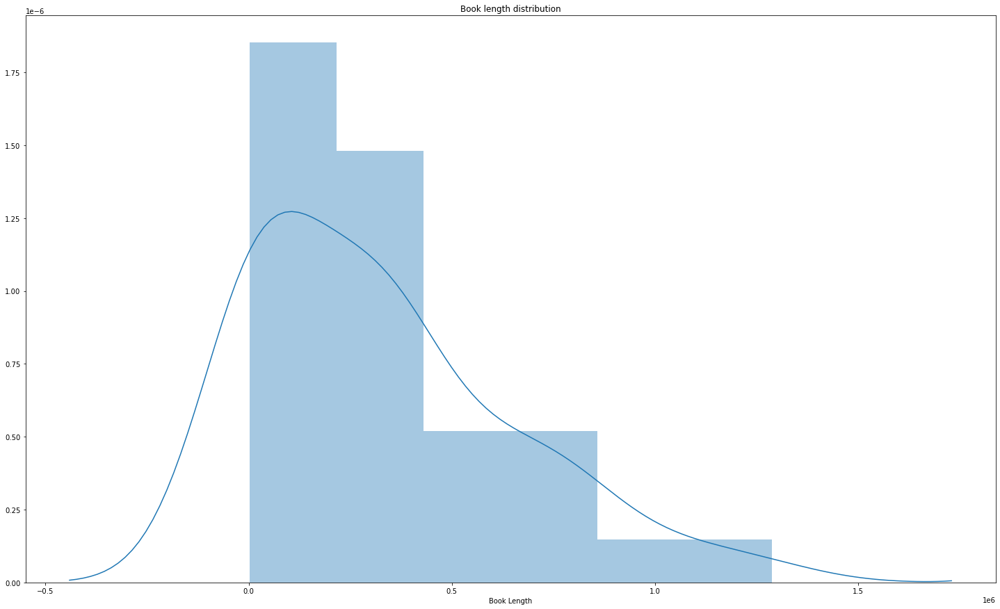

In [29]:
plt.figure(figsize=(25,15))
sns.distplot(final_df['Book Length']).set_title('Book length distribution');

In [30]:
final_df['Book Length'].describe()

count    6.300000e+01
mean     3.281883e+05
std      3.206899e+05
min      1.932000e+03
25%      3.610650e+04
50%      2.842620e+05
75%      4.667045e+05
max      1.287408e+06
Name: Book Length, dtype: float64

- Articles with more than 10.000 caracters

In [31]:
df_more10k = final_df[final_df['Book Length'] > 10000]
len(df_more10k)

59

In [32]:
df_more10k.head()

,file_name,text,Author,Book Length
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva,17783
1,acabouSe.txt,\n\n\nAcabou-se!\nLuísa Marques da Silva\n\nTí...,Luísa Marques Silva,31904
2,Botão.txt,O terrível caso do botão assassino\nLuísa Marq...,Luísa Marques Silva,40116
3,controlz.txt,CONTROL Z\nChegou a hora de vos contar. Chegou...,Luísa Marques Silva,11133
4,emedo.txt,Título\ne-medo\n\nAutora (inspiradíssima)\nLuí...,Luísa Marques Silva,52506


### 2. Cleaning The Data¶

When dealing with numerical data, data cleaning often involves removing null values and duplicate data, dealing with outliers, etc. With text data, there are some common data cleaning techniques, which are also known as text pre-processing techniques.

With text data, this cleaning process can go on forever. There's always an exception to every cleaning step. So, we're going to start simple and iterate. Here are a bunch of things you can do to clean your data. We're going to execute just the common cleaning steps here and the rest can be done at a later point to improve our results.

Common data cleaning steps on all text:

- Make text all lower case
- Remove punctuation
- Remove numerical values
- Remove common non-sensical text (/n)
- Tokenize text
- Remove stop words
- More data cleaning steps after tokenization:
- Stemming / lemmatization
- Parts of speech tagging
- Create bi-grams or tri-grams
- Deal with typos

In [33]:
text = final_df["text"]

In [34]:
text_list = list(text)

words_in_df = ''.join(text_list).split()

- Special character cleaning

In [35]:
# \r  \n and \t

final_df['Text_Parsed_1'] = final_df['text'].str.replace("\r", " ")
final_df['Text_Parsed_1'] = final_df['Text_Parsed_1'].str.replace("\n", " ")
final_df['Text_Parsed_1'] = final_df['Text_Parsed_1'].str.replace("   ", " ")
final_df['Text_Parsed_1'] = final_df['Text_Parsed_1'].str.replace("\t", " ")

In [36]:
# " when quoting text
final_df['Text_Parsed_1'] = final_df['Text_Parsed_1'].str.replace('"', '')

- Uppercase/Lowercase

In [37]:
# Lowercasing the text

final_df['Text_Parsed_2'] = final_df['Text_Parsed_1'].str.lower()

- Punctuation Signs

In [38]:
punctuation_signs = list("?:!.,;+*)(...-")

final_df['Text_Parsed_3'] = final_df['Text_Parsed_2']

for punct_sign in punctuation_signs:
    final_df['Text_Parsed_3'] = final_df['Text_Parsed_3'].str.replace(punct_sign, '')

- Stemming and Lemmatization

In [39]:
# Saving the lemmatizer into an object

wordnet_lemmatizer = WordNetLemmatizer()

In [40]:
nrows = len(final_df)
lemmatized_text_list = []

for row in range(0, nrows):
    
    # Create an empty list containing lemmatized words
    
    lemmatized_list = []
    
    # Save the text and its words into an object
    
    text = final_df.loc[row]['Text_Parsed_3']
    text_words = text.split(" ")

    # Iterate through every word to lemmatize
    for word in text_words:
        lemmatized_list.append(wordnet_lemmatizer.lemmatize(word, pos="v"))
        
    # Join the list
    lemmatized_text = " ".join(lemmatized_list)
    
    # Append to the list containing the texts
    lemmatized_text_list.append(lemmatized_text)
    

In [41]:
final_df['Text_Parsed_4'] = lemmatized_text_list

- Stop words

In [42]:
stop_words = list(stopwords.words('portuguese'))

In [43]:
stop_words[0:5]

['de', 'a', 'o', 'que', 'e']

In [44]:
final_df["Text_Parsed_5"] = final_df['Text_Parsed_4']

for stop_word in stop_words:

    regex_stopword = r"\b" + stop_word + r"\b"
    final_df['Text_Parsed_5'] = final_df['Text_Parsed_5'].str.replace(regex_stopword, '')

- Remvove numercal caracters

In [45]:
final_df["Text_Parsed_6"] = final_df['Text_Parsed_5']

final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("0", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("1", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("2", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("3", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("4", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("5", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("6", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("7", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("8", " ")
final_df['Text_Parsed_6'] = final_df['Text_Parsed_6'].str.replace("9", " ")

In [46]:
final_df['Text_Parsed_7'] = final_df['Text_Parsed_6'].str.replace("   ", " ")

- Compare Results

In [47]:
final_df.loc[5]['text'][0:1000]

'LISBOA 2050\nLisboa, ano de 2050. Um Agosto tão gelado como há vinte anos atrás. Um dia vinte e três tão triste como sempre. Umas seis e um quarto da manhã carregadas de geada e desconsolo.\nAlfredo levantou se novamente com a sensação de não saber onde estava. Demorou uns minutos a focar os velhos olhos no quarto sofisticado e impessoal que o albergava desde há cinco anos, mas cuja decoração contava com alguns objectos que conseguira guardar do seu passado: o pesado e valioso espelho francês que comprara num leilão perdido no tempo e no espaço; a cadeira encarnada, de braços em madeira escura, que lhe oferecera uma das inúmeras mulheres que tinham passado pela sua vida e da qual apenas recordava os olhos pretos e profundos; o tapete felpudo, em tons de vermelho, algo gasto no centro, que fora o orgulho da sua já há muito falecida mãe…\nFoi o copo de água em cima da mesinha de cabeceira de recorte moderno que o trouxe à realidade. Levantou se com alguma dificuldade − o reumatismo não 

In [48]:
final_df.loc[5]['Text_Parsed_7'][0:1000]

'lisboa  lisboa ano    agosto tão gelado vinte anos atrás  dia vinte  três tão triste  sempre umas seis quarto  manhã carregadas  geada  desconsolo alfredo levantou  novamente sensação saber onde  demorou uns minutos  focar  velhos olhos  quarto sofisticado  impessoal albergava desde  cinco anos  cuja decoração contava  alguns objectos  conseguira guardar passado  pesado  valioso espelho francês  comprara  leilão perdido  tempo espaço  cadeira encarnada  braços  madeira escura oferecera inúmeras mulheres passado vida  apenas recordava  olhos pretos  profundos  tapete felpudo  tons  vermelho algo gasto  centro  orgulho  falecida mãe… copo  água  cima  mesinha  cabeceira  recorte moderno trouxe  realidade levantou alguma dificuldade −  reumatismo  perdoava −  dirigiu  espelho estacou defronte  imagem  devolvida  durante longos  ansiosos minutos analisou  cuidadosamente  deixar passar  cantinho  rosto  pegou  espelhito pequeno  fê lo reflectir pescoço observando minuciosamente todas  preg

In [49]:
final_df.loc[15]['text'][0:1000]

'MEMORIAL DO CONVENTO José Saramago JOSÉ SARAMAGO nasceu na Golegã em 16 de Dezembro de 1932, no seio de uma família de trabalhadores rurais. Veio para Lisboa muito novo, onde fez o curso secundário. Foi director literário numa editora, colaborou na revista Seara Nova, no vespertino Diário de Lisboa e foi director- adjunto do matutino Diário de Noticias (de Abril a Novembro de 1975). A partir de 1976 dedicou-se completamente à literatura. Os seus romances têm sido publicados no Brasil, Espanha, Itália, Alemanha, Rússia, França, etc. Principais prémios: Levantado do Chão (1980), Prémio Cidade de Lisboa; Memorial do Convento (1982), Prémio Literário Município de Lisboa; Ano da Morte de Ricardo Reis (1984), Prémio Pen Club Português.\n\nReside actualmente em Espanha.\n\nEditorial Caminho, SA. Lisboa, 1982 (c) Editores Reunidos, Lda., Lisboa, 1994, para a presente edição\n\nD. João, quinto do nome na tabela real, irá esta noite ao quarto de sua mulher, D. Maria Ana Josefa, que chegou há ma

In [50]:
final_df.loc[15]['Text_Parsed_7'][0:1000]

'memorial  convento josé saramago josé saramago nasceu  golegã  dezembro    seio família  trabalhadores rurais veio  lisboa  novo onde fez  curso secundário  director literário  editora colaborou  revista seara nova  vespertino diário  lisboa director adjunto  matutino diário  noticias  abril  novembro    partir   dedicouse completamente  literatura romance têm sido publicados  brasil espanha itália alemanha rússia frança etc principais prémios levantado  chão  prémio cidade  lisboa memorial  convento  prémio literário município  lisboa ano  morte  ricardo reis  prémio pen club português  reside actualmente  espanha  editorial caminho sa lisboa  c editores reunidos lda lisboa    presente edição  d joão quinto  nome  tabela real irá  noite  quarto mulher d maria ana josefa  chegou  dois anos  áustria  dar infantes  coroa portuguesa hoje ainda  emprenhou  murmura  corte dentro  palácio rainha provavelmente madre seca insinuação  resguardada  orelhas  bocas delatoras   íntimos  confia  ca

In [51]:
final_df.head(1)

,file_name,text,Author,Book Length,Text_Parsed_1,Text_Parsed_2,Text_Parsed_3,Text_Parsed_4,Text_Parsed_5,Text_Parsed_6,Text_Parsed_7
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva,17783,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,a bela história de dinis e beatriz ou requiem ...,a bela história de dinis e beatriz ou requiem ...,a bela história de dinis e beatriz ou requiem ...,bela história dinis beatriz requiem borb...,bela história dinis beatriz requiem borb...,bela história dinis beatriz requiem borbul...


In [52]:
list_columns = ["file_name", "text", "Author", "Book Length","Text_Parsed_6"]

df = final_df[list_columns]

df = df.rename(columns={'Text_Parsed_6': 'Final_Text'})

In [53]:
df

,file_name,text,Author,Book Length,Final_Text
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva,17783,bela história dinis beatriz requiem borb...
1,acabouSe.txt,\n\n\nAcabou-se!\nLuísa Marques da Silva\n\nTí...,Luísa Marques Silva,31904,acabouse luísa marques silva título acabous...
2,Botão.txt,O terrível caso do botão assassino\nLuísa Marq...,Luísa Marques Silva,40116,terrível caso botão assassino luísa marques ...
3,controlz.txt,CONTROL Z\nChegou a hora de vos contar. Chegou...,Luísa Marques Silva,11133,control z chegou hora contar chegou hora ...
4,emedo.txt,Título\ne-medo\n\nAutora (inspiradíssima)\nLuí...,Luísa Marques Silva,52506,título emedo autora inspiradíssima luísa marq...
...,...,...,...,...,...
58,pg22969.txt,\n\n\nEXPOSIÇÃO\n\n+amadeo\nde souza\ncardoso+...,Almada Negreiros,3439,exposição amadeo souza cardoso liga naval ...
59,pg23133.txt,\n\n*JOSÉ DE ALMADA-NEGREIROS*\n\n\n*K4\n\no q...,Almada Negreiros,39990,josé almadanegreiros k quadrado azul a...
60,pg23620.txt,"\n\n*""ORPHEU""*\n\nREVISTA TRIMESTRAL DE LITERA...",Almada Negreiros,93300,orpheu revista trimestral literatura portu...
61,pg23879.txt,\n\n+a ENGOMADEIRA+\n\nNOVELA VULGAR LISBOETA\...,Almada Negreiros,70806,engomadeira novela vulgar lisboeta engom...


- Author Coding

In [54]:
category_codes = {
    'Luísa Marques Silva': 1,
    'José Saramago': 2,
    'José Rodrigues Santos': 3,
    'Eça de Queirós': 4,
    'Camilo Castelo Branco': 5,
    "Almada Negreiros":6
}

In [55]:
# Category mapping
df['Category_Code'] = df['Author']
df = df.replace({'Category_Code':category_codes})

In [56]:
df.head()

,file_name,text,Author,Book Length,Final_Text,Category_Code
0,ABelaHistoria.txt,A BELA HISTÓRIA DE DINIS E BEATRIZ OU REQUIEM ...,Luísa Marques Silva,17783,bela história dinis beatriz requiem borb...,1
1,acabouSe.txt,\n\n\nAcabou-se!\nLuísa Marques da Silva\n\nTí...,Luísa Marques Silva,31904,acabouse luísa marques silva título acabous...,1
2,Botão.txt,O terrível caso do botão assassino\nLuísa Marq...,Luísa Marques Silva,40116,terrível caso botão assassino luísa marques ...,1
3,controlz.txt,CONTROL Z\nChegou a hora de vos contar. Chegou...,Luísa Marques Silva,11133,control z chegou hora contar chegou hora ...,1
4,emedo.txt,Título\ne-medo\n\nAutora (inspiradíssima)\nLuí...,Luísa Marques Silva,52506,título emedo autora inspiradíssima luísa marq...,1


In [75]:
df_more10k = final_df[final_df['Book Length'] < 1900]
len(df_more10k)

0

### 3. Train Test Split

In [141]:
X_train, X_test, y_train, y_test = train_test_split(df['Final_Text'], df['Category_Code'], test_size=0.3, random_state=42)

### 4. Text Representation

We have various options:

- Count Vectors as features
- TF-IDF Vectors as features
- Word Embeddings as features
- Text / NLP based features
- Topic Models as features

In [142]:
# Parameter election
ngram_range = (1,2)
min_df = 1
max_df = 10
max_features = 1000000000

In [143]:
tfidf = TfidfVectorizer(encoding='utf-8',
                        ngram_range=ngram_range,
                        stop_words=None,
                        lowercase=False,
                        max_df=max_df,
                        min_df=min_df,
                        max_features=max_features,
                        norm='l2',
                        sublinear_tf=True)
                        
features_train = tfidf.fit_transform(X_train).toarray()
labels_train = y_train
print(features_train.shape)

features_test = tfidf.transform(X_test).toarray()
labels_test = y_test
print(features_test.shape)

(44, 1264882)
(19, 1264882)


In [144]:
from sklearn.feature_selection import chi2
import numpy as np

for Product, category_id in sorted(category_codes.items()):
    features_chi2 = chi2(features_train, labels_train == category_id)
    indices = np.argsort(features_chi2[0])
    feature_names = np.array(tfidf.get_feature_names())[indices]
    unigrams = [v for v in feature_names if len(v.split(' ')) == 1]
    bigrams = [v for v in feature_names if len(v.split(' ')) == 2]
    print("# '{}' category:".format(Product))
    print("  . Most correlated unigrams:\n. {}".format('\n. '.join(unigrams[-5:])))
    print("  . Most correlated bigrams:\n. {}".format('\n. '.join(bigrams[-2:])))
    print("")

# 'Almada Negreiros' category:
  . Most correlated unigrams:
. almadanegreiros
. dantas
. prá
. souzacardoso
. amadeo
  . Most correlated bigrams:
. liga naval
. amadeo souzacardoso

# 'Camilo Castelo Branco' category:
  . Most correlated unigrams:
. ancias
. deshonra
. mafalda
. julia
. emilio
  . Most correlated bigrams:
. aquella mulher
. emilio cunha

# 'Eça de Queirós' category:
  . Most correlated unigrams:
. pittoresco
. tipoia
. _gazeta
. paletot
. _times_
  . Most correlated bigrams:
. lord beaconsfield
. outr ora

# 'José Rodrigues Santos' category:
  . Most correlated unigrams:
. tomás
. anfitrião
. hã
. hmm
. constatou
  . Most correlated bigrams:
. ergueu dedo
. fez ar

# 'José Saramago' category:
  . Most correlated unigrams:
. caim
. saramago
. supondo
. indispensável
. porquanto
  . Most correlated bigrams:
. josé saramago
. umas quantas

# 'Luísa Marques Silva' category:
  . Most correlated unigrams:
. sapopt
. porreiros
. luísa
. wnfe
. liseta
  . Most correlated bigr

In [145]:
#bigrams

### Model Training¶

Once we have our feature vectors built, we'll try several machine learning classification models in order to find which one performs best on our data. We will try with the following models:

- Random Forest
- Support Vector Machine
- K Nearest Neighbors
- Multinomial Naïve Bayes
- Multinomial Logistic Regression

#### KNN

In [146]:
knn =KNeighborsClassifier()

In [147]:
knn.fit(features_train, labels_train)

KNeighborsClassifier()

In [148]:
knn_pred = knn.predict(features_test)

knn_pred

array([4, 6, 3, 4, 3, 5, 2, 3, 3, 4, 6, 2, 5, 2, 5, 5, 3, 2, 5],
      dtype=int64)

- Training accuracy

In [149]:
print("The training accuracy is: ")
print(accuracy_score(labels_train, knn.predict(features_train)))

The training accuracy is: 
0.9545454545454546


- Test accuracy

In [150]:
print("The test accuracy is: ")
print(accuracy_score(labels_test, knn_pred))

The test accuracy is: 
0.631578947368421


In [151]:
# Classification report

print("Classification report")

print(classification_report(labels_test,knn_pred))

Classification report
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         3
           2       1.00      0.80      0.89         5
           3       0.20      1.00      0.33         1
           4       0.00      0.00      0.00         0
           5       1.00      0.83      0.91         6
           6       1.00      0.50      0.67         4

    accuracy                           0.63        19
   macro avg       0.53      0.52      0.47        19
weighted avg       0.80      0.63      0.68        19



C:\Users\raimu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\raimu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\raimu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\raimu\anaconda3\lib\site-packages\sklearn\metrics\_cla

- Confusion Matrix

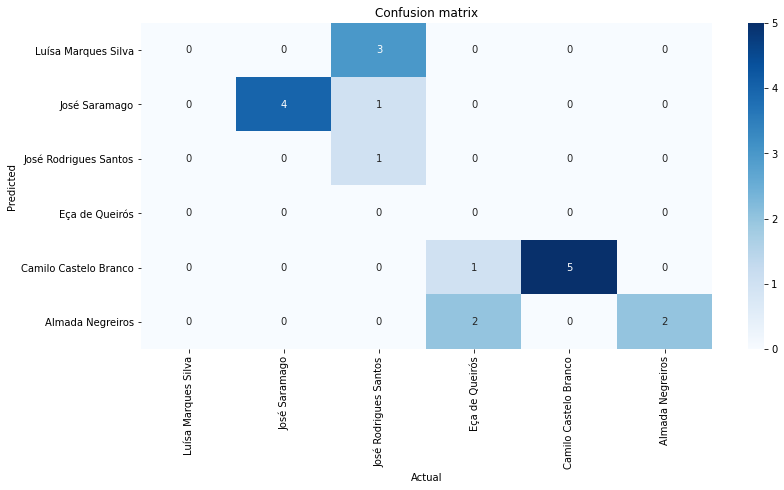

In [152]:
aux_df = df[['Author', 'Category_Code']].drop_duplicates().sort_values('Category_Code')
conf_matrix = confusion_matrix(labels_test, knn_pred)
plt.figure(figsize=(12.8,6))
sns.heatmap(conf_matrix, 
            annot=True,
            xticklabels=aux_df['Author'].values, 
            yticklabels=aux_df['Author'].values,
            cmap="Blues")
plt.ylabel('Predicted')
plt.xlabel('Actual')
plt.title('Confusion matrix')
plt.show()

- Multinomial Naïve Bayes

In [153]:
mnbc = MultinomialNB()
mnbc

MultinomialNB()

In [ ]:
mnbc.fit(features_train, labels_train)

In [ ]:
mnbc_pred = mnbc.predict(features_test)

mnbc_pred

- Training accuracy

In [ ]:
# Training accuracy
print("The training accuracy is: ")
print(accuracy_score(labels_train, mnbc.predict(features_train)))

In [ ]:
# Test accuracy
print("The test accuracy is: ")
print(accuracy_score(labels_test, mnbc_pred))

In [ ]:
# Classification report
print("Classification report")
print(classification_report(labels_test,mnbc_pred))

In [ ]:
aux_df = df[['Author', 'Category_Code']].drop_duplicates().sort_values('Category_Code')
conf_matrix = confusion_matrix(labels_test, mnbc_pred)
plt.figure(figsize=(12.8,6))
sns.heatmap(conf_matrix, 
            annot=True,
            xticklabels=aux_df['Author'].values, 
            yticklabels=aux_df['Author'].values,
            cmap="Blues")
plt.ylabel('Predicted')
plt.xlabel('Actual')
plt.title('Confusion matrix')
plt.show()

- Random Forest

In [ ]:
rf = RandomForestClassifier()

In [ ]:
rf.fit(features_train, labels_train)

In [ ]:
rfc_pred = rf.predict(features_test)
rfc_pred

In [ ]:
# Training accuracy
print("The training accuracy is: ")
print(accuracy_score(labels_train, rf.predict(features_train)))

In [ ]:
# Test accuracy
print("The test accuracy is: ")
print(accuracy_score(labels_test, rfc_pred))

In [ ]:
# Classification report
print("Classification report")
print(classification_report(labels_test,rfc_pred))

In [ ]:
aux_df = df[['Author', 'Category_Code']].drop_duplicates().sort_values('Category_Code')
conf_matrix = confusion_matrix(labels_test, rfc_pred)
plt.figure(figsize=(12.8,6))
sns.heatmap(conf_matrix, 
            annot=True,
            xticklabels=aux_df['Author'].values, 
            yticklabels=aux_df['Author'].values,
            cmap="Blues")
plt.ylabel('Predicted')
plt.xlabel('Actual')
plt.title('Confusion matrix')
plt.show()

- Support Vector Machine

In [ ]:
svc = svm.SVC()

In [ ]:
svc.fit(features_train, labels_train)

In [ ]:
svc_pred = svc.predict(features_test)
svc_pred

In [ ]:
# Training accuracy
print("The training accuracy is: ")
print(accuracy_score(labels_train, svc.predict(features_train)))

In [ ]:
# Test accuracy
print("The test accuracy is: ")
print(accuracy_score(labels_test, svc_pred))